In [1]:
%%capture
!pip install mediapipe

In [2]:
import numpy as np
import os,cv2,math,glob,random
import scipy.io as sio
from math import cos, sin
from pathlib import Path
import pandas as pd
import mediapipe
import warnings
warnings.filterwarnings('ignore')
from google.colab.patches import cv2_imshow

In [3]:
# Loading AFLW2000 Data
%%capture
if os.path.isfile('/content/AFLW2000-3D.zip') == False:
  !gdown --id  1fP3zvSCYjll_o_m7S12nvQLZ9MnsEoap
  !unzip /content/AFLW2000-3D.zip

In [4]:


def draw_axis(img, pitch,yaw,roll, tdx=None, tdy=None, size = 100):

    yaw = -yaw
    if tdx != None and tdy != None:
        tdx = tdx
        tdy = tdy
    else:
        height, width = img.shape[:2]
        tdx = width / 2
        tdy = height / 2

    # X-Axis pointing to right. drawn in red
    x1 = size * (cos(yaw) * cos(roll)) + tdx
    y1 = size * (cos(pitch) * sin(roll) + cos(roll) * sin(pitch) * sin(yaw)) + tdy

    # Y-Axis | drawn in green
    #        v
    x2 = size * (-cos(yaw) * sin(roll)) + tdx
    y2 = size * (cos(pitch) * cos(roll) - sin(pitch) * sin(yaw) * sin(roll)) + tdy

    # Z-Axis (out of the screen) drawn in blue
    x3 = size * (sin(yaw)) + tdx
    y3 = size * (-cos(yaw) * sin(pitch)) + tdy

    cv2.line(img, (int(tdx), int(tdy)), (int(x1),int(y1)),(0,0,255),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x2),int(y2)),(0,255,0),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x3),int(y3)),(255,0,0),2)

    return img



prepare the data

all_imgs is a list of the names of all images (including .jpg)

In [21]:
all_imgs = []
for filename in os.listdir('AFLW2000'):
    if filename.endswith("jpg"): 
        # Your code comes here such as 
        #print(filename)
        all_imgs.append(filename)
print(len(all_imgs))
all_imgs[1]

2000


'image04180.jpg'

In [22]:
x_list , y_list = [] , []
for img in all_imgs:
  x,y , mouth , nose = get_xy_points(img)
  x_list.append(x)
  y_list.append(y)
print(len(x_list))
print(len(y_list))

2000
2000


In [23]:
empty_imgs = [all_imgs[i] for i in range(len(x_list)) if len(x_list[i]) == 0]

In [24]:
len(empty_imgs) # around 7% of the images can't be interpreted from mediapipe library

147

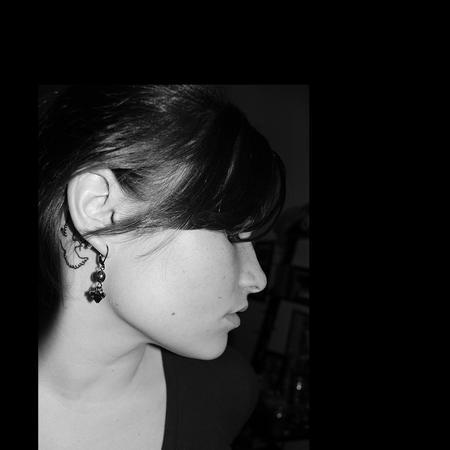

2


In [25]:
draw(empty_imgs[50])

drop these images

In [26]:
valid_imgs = [img for img in all_imgs if img not in empty_imgs]

In [27]:
lst = [1,2,3]
lst2 = lst.copy()
del lst2[0]
print(lst)
print(lst2)

[1, 2, 3]
[2, 3]


In [28]:

len(valid_imgs)

1853

In [29]:
print(len(x_list[0])) ## 468 features
selected_indecies = [index for index in range(len(x_list[0])) if index%9 ==0]
selected_indecies = [index for index in range(len(x_list[0])) if index%9 ==0]

len(selected_indecies)

468


52

In [30]:
x_list , y_list , mouth_list , edge_list = [] , [] , [] ,[]
pitch_list , yaw_list , roll_list = [] , [] ,[]
for img in valid_imgs:
  x,y , mouth , edge = get_xy_points(img)
  pitch , yaw ,roll = get_ouput(img)
  x_list.append(x[selected_indecies]) ## only the points we want
  y_list.append(y[selected_indecies]) ## only the points we want
  mouth_list.append(mouth)
  #nose_list.append(nose)
  edge_list.append(edge)
  pitch_list.append(pitch)
  yaw_list.append(yaw)
  roll_list.append(roll)
print(len(x_list))
print(len(y_list))
print(roll_list[0])

1853
1853
-0.07607973


In [31]:
edge_list[0][1] #y_point of edge

212

In [32]:
print(pitch_list[0])

0.075391


In [33]:
print(len(x_list[0]))

52


normalize the features (x-x_nose)/(norm(mouth,nose)

shape is  (450, 450, 3)


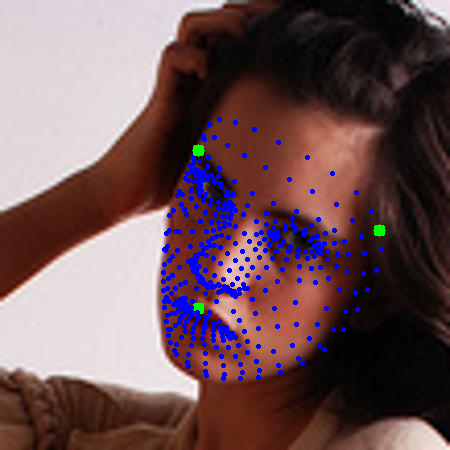

2


In [34]:
draw(valid_imgs[1000])

In [35]:
len(x_list)

1853

In [36]:

norms_x = [np.linalg.norm((mouth_list[i][0]) - (edge_list[i][0])) for i in range(len(x_list)) ]
norms_without_zeros_x = [1 if norm == 0 else norm for norm in norms_x ]

zero_index_x = [index for index in range(len(norms_x)) if norms_x[index]==0]
print(zero_index_x)
#print(norms_x[zero_index_x[0]])

norms_y = [np.linalg.norm((mouth_list[i][1]) - (edge_list[i][1])) for i in range(len(x_list)) ]
zero_index_y = [index for index in range(len(norms_y)) if norms_y[index]==0]
print(zero_index_y)

norms_y = [np.linalg.norm((mouth_list[i][1]) - (edge_list[i][1])) for i in range(len(x_list)) ]
norms_without_zeros_y = [1 if norm == 0 else norm for norm in norms_y ]
len(norms_without_zeros_x)#.shpae

[]
[152, 349, 505, 564, 662, 780, 917, 948, 968, 1150, 1185, 1194, 1328, 1533, 1538, 1567, 1693, 1696, 1697, 1710]


1853

In [37]:
np.linalg.norm(np.array((1,2)) - np.array((2,3)))

1.4142135623730951

In [38]:
normalized_x_list = [( x_list[i] - mouth_list[i][0] ) / norms_without_zeros_x[i] for i in range(len(x_list)) if i not in zero_index_x and i not in zero_index_y] #[0] means the x point
normalized_y_list = [( y_list[i] - mouth_list[i][1] ) / norms_without_zeros_y[i] for i in range(len(x_list)) if i not in zero_index_x and i not in zero_index_y] #[0] means the x point

#normalized_x_list = [( x_list[i] - mouth_list[i][0] ) / np.linalg.norm(mouth_list[i] - edge_list[i]) for i in range(len(x_list)) ] #[0] means the x point
#normalized_y_list = [( y_list[i] - mouth_list[i][1] ) / np.linalg.norm(mouth_list[i] - edge_list[i]) for i in range(len(x_list)) ] #[0] means the x point


#normalized_x_list = [item if item is not nan else 200 for lst in normalized_x_list]
for item in zero_index_y:
  zero_index_x.append(item)

pitch_list2 = pitch_list.copy()
roll_list2 = roll_list.copy()
yaw_list2 = yaw_list.copy()
for i in zero_index_x:
  del pitch_list2[i]
  del roll_list2[i]
  del yaw_list2[i]
#np.linalg.norm((mouth_list[i]) - (edge_list[i]))
print(len(normalized_y_list))
print(len(normalized_x_list[0]))
#normalized_x_list = x_list
#normalized_y_list = y_list

1833
52


In [39]:

len(normalized_y_list)

1833

In [40]:
df_raw = pd.DataFrame({'features x':normalized_x_list , 'features y' : normalized_y_list , 'pitch':pitch_list2
                       ,'roll': roll_list2 , 'yaw': yaw_list2
                       })
df_raw.shape

(1833, 5)

make the final data frame

In [41]:
df_x = pd.DataFrame(df_raw['features x'].to_list() )
df_y = pd.DataFrame(df_raw['features y'].to_list(), columns = list(range(52,104)))#list(range(468,936)))#list(range(52,104)))
df = pd.concat([df_raw , df_x , df_y ], axis = 1)
df.drop(columns= ['features x' , 'features y'] , inplace = True)
df.shape

(1833, 107)

In [42]:
from sklearn.model_selection import train_test_split
target_columns = ['yaw','pitch' , 'roll']
x_train , x_test , y_train , y_test = train_test_split(df.drop(columns = target_columns) ,
                                                       df[target_columns] ,
                                                       test_size = 0.1 , 
                                                       shuffle = True ,
                                                       random_state = 42
                                                       )

In [43]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(1649, 104)
(1649, 3)
(184, 104)
(184, 3)


In [44]:
x_test

,0,1,2,3,4,5,6,7,8,9,...,94,95,96,97,98,99,100,101,102,103
985,-0.145833,0.062500,-0.322917,-0.291667,-0.385417,0.041667,-0.635417,-0.406250,-0.239583,-0.364583,...,5.045455,0.727273,5.318182,4.136364,0.636364,2.636364,3.590909,0.454545,1.318182,2.636364
1502,-0.299020,-0.323529,-0.328431,-0.647059,-0.583333,-0.308824,-0.887255,-0.784314,-0.357843,-0.406863,...,13.461538,2.692308,14.461538,11.538462,2.615385,7.692308,10.153846,1.769231,4.230769,7.846154
711,-0.521978,-0.258242,-0.703297,-0.565934,-0.714286,-0.417582,-0.758242,-0.659341,-0.609890,-0.692308,...,1.604396,0.065934,1.582418,1.175824,-0.087912,0.637363,1.109890,-0.175824,0.252747,0.494505
862,-1.009434,-0.952830,-0.933962,-1.075472,-1.103774,-1.160377,-1.084906,-1.169811,-1.037736,-1.000000,...,119.000000,24.000000,119.000000,94.000000,18.000000,62.000000,90.000000,13.000000,35.000000,58.000000
1820,-0.676471,-0.676471,-0.610294,-0.882353,-0.867647,-0.779412,-1.000000,-0.992647,-0.720588,-0.713235,...,5.464286,0.857143,5.750000,4.678571,0.857143,2.642857,3.857143,0.571429,1.428571,2.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
414,-0.484536,-0.505155,-0.474227,-0.768041,-0.721649,-0.536082,-0.953608,-0.902062,-0.536082,-0.561856,...,10.529412,2.000000,11.176471,9.176471,2.411765,6.235294,8.117647,1.764706,3.647059,6.294118
78,-1.552632,-1.302632,-1.460526,-1.342105,-1.473684,-1.710526,-1.171053,-1.368421,-1.565789,-1.500000,...,14.333333,1.333333,13.777778,10.555556,1.111111,6.333333,10.000000,0.222222,3.111111,5.222222
59,-0.455696,-0.632911,-0.360759,-0.835443,-0.740506,-0.601266,-1.012658,-0.981013,-0.512658,-0.518987,...,2.600000,0.507692,2.800000,2.184615,0.615385,1.369231,1.800000,0.476923,0.800000,1.430769
637,-0.924370,-0.865546,-0.857143,-1.008403,-1.016807,-1.025210,-1.067227,-1.100840,-0.949580,-0.924370,...,10.500000,2.000000,10.857143,9.000000,2.214286,6.214286,8.357143,1.571429,3.571429,6.000000


In [45]:
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.metrics import accuracy_score , r2_score , mean_absolute_error
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import AdaBoostRegressor , RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR

lr = LinearRegression()
knn = KNN(n_neighbors=7)
knn.fit(x_train , y_train)
print('=======================================KNN=============================================')
print('score of knn in train is ' , knn.score(x_train , y_train))
print('score of knn in test is ' , knn.score(x_test , y_test))
lr.fit(x_train , y_train)
#lr.score(x_train , y_train)
print('=======================================linear regression=============================================')
print('accuracy of train is ' , lr.score(x_train , y_train))
y_predict = lr.predict(x_test)
print('accuracy of test is ' ,r2_score( y_test , y_predict))
print('=======================================ada boost=============================================')
multioutputregressor = MultiOutputRegressor(AdaBoostRegressor(random_state=42, n_estimators=100)).fit(x_train, y_train)
predictions = multioutputregressor.predict(x_test)
prediction_train = multioutputregressor.predict(x_train)
r2 = r2_score(y_test, predictions)
r2_train = r2_score(y_train , prediction_train)
print('R2 score train is ',r2_train)
print('R2 score test is {}'.format(r2))

print('=======================================decision tree=============================================')
decision_tree = DecisionTreeRegressor()
decision_tree.fit(x_train , y_train)
print('r2 score of train is ' , decision_tree.score(x_train , y_train))
print('r2 score of test is ' ,decision_tree.score( x_test , y_test))

print('=======================================random forest=============================================')
random_forest = RandomForestRegressor()
random_forest = random_forest.fit(x_train , y_train)
print('r2 score of train is ' , random_forest.score(x_train , y_train))
print('r2 score of test is ' ,random_forest.score( x_test , y_test))

print('=======================================SVR=============================================')
svr = MultiOutputRegressor(SVR())
svr = svr.fit(x_train , y_train)
print('r2 score of train is ' , svr.score(x_train , y_train))
print('r2 score of test is ' ,svr.score( x_test , y_test))

#lr.predict([x_test.iloc[0,:]])
#print(y_predict[0])
#print(y_test.iloc[0,:])

=======================================KNN=============================================
score of knn in train is  0.39638488794786814
score of knn in test is  0.614244725489386
=======================================linear regression=============================================
accuracy of train is  0.4798105339289172
accuracy of test is  0.18207837633630453
=======================================ada boost=============================================
R2 score train is  0.7019427991704994
R2 score test is 0.2237983243872058
=======================================decision tree=============================================
r2 score of train is  1.0
r2 score of test is  0.36123794023862393
=======================================random forest=============================================
r2 score of train is  0.8899293854413731
r2 score of test is  0.7388129659073344
=======================================SVR=============================================
r2 score of train is  0.290543061307441

shape is  (4480, 2016, 3)


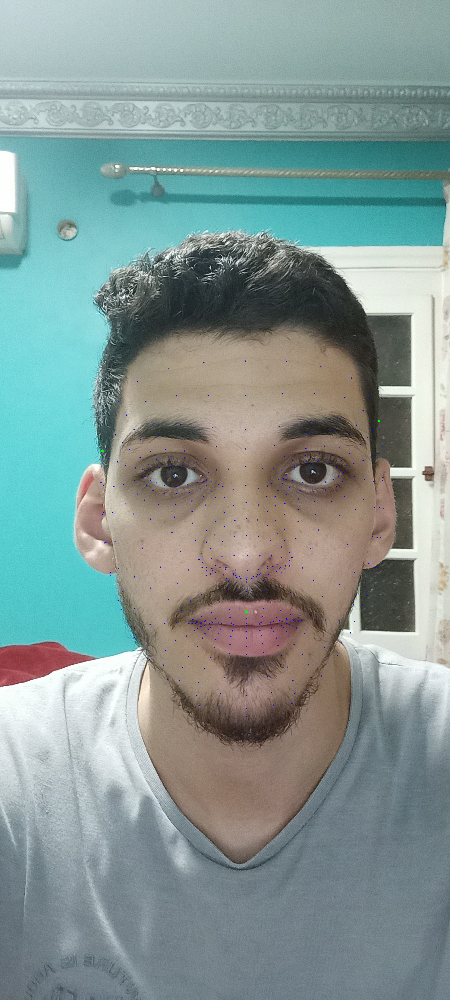

2


NameError: ignored

In [ ]:
##read your image and draw axis
##read video , draw axis on it
##using random forest
draw('IMG20220617030506.jpg')



(104,)
52
104


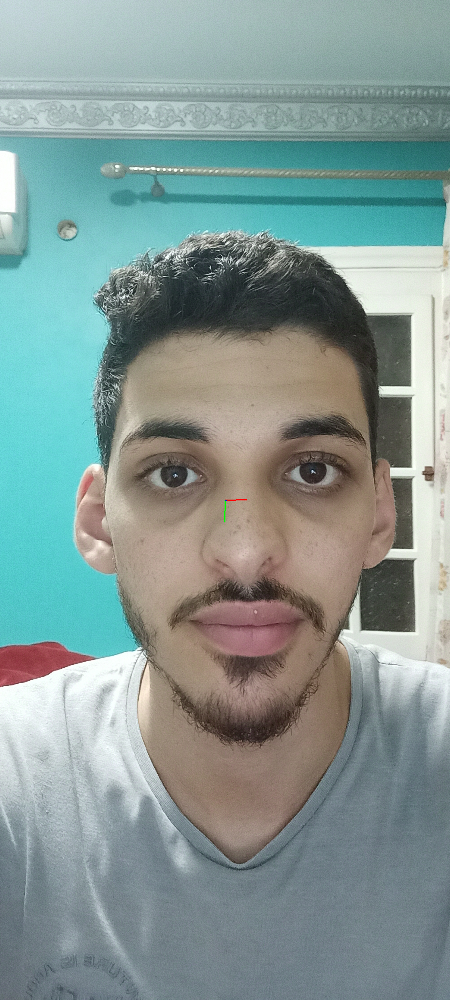

In [ ]:
x_list , y_list , edge1 , edg2 = get_xy_points('IMG20220617030506.jpg')
x_list = x_list[selected_indecies]
y_list = y_list[selected_indecies]

x_list_normalized = ( x_list - edge1[0] ) / np.linalg.norm(edge1[0] - edge2[0])
y_list_normalized = (y_list - edge1[1]) / np.linalg.norm(edge1[1] - edge2[1])

features = np.array(x_list_normalized + y_list_normalized)
random_forest.predict([features])

In [46]:
VFILE = '/content/drive/MyDrive/Colab Notebooks/video.mp4'
def get_frames(file_name):
    video = cv2.VideoCapture(file_name)
    while video.isOpened():
        ret , frame = video.read() # ret is true or false (false when the video is closed)
        if ret :
            yield frame # yield is like return but for (generator functions) used to return multiple values (fast and easy)
        else:
            break
    video.release()
    yield None

In [57]:
from google.colab.patches import cv2_imshow
video_name = 'out.mp4'
for f in get_frames(VFILE):
    if f is None:
        break
    height, width, channels = f.shape
    break
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video = cv2.VideoWriter(video_name, fourcc, 10, (width, height))

for f in get_frames(VFILE):
    if f is None:
        break
    #cv2_imshow(f)
    ## media piplie use the image in RGB ##
    image = f # cv2.cvtColor(f , cv2.COLOR_BGR2RGB)
    x_list , y_list , edge1 , edge2 = get_ouput(image)
    if x_list ==[] or y_list ==[] or edge1.shape[0] == 0 or edge2.shape[0] == 0 :
      continue
    x_list_normalized , y_list_normalized = normalize(x_list[selected_indecies] , y_list[selected_indecies] , edge1 , edge2)
    if x_list_normalized == [] or y_list_normalized == []:
      continue
    all_features_list = list(x_list_normalized) + list(y_list_normalized)
    features = np.array(all_features_list)
    prediction = random_forest.predict([features])
    pitch , yaw , roll = (prediction[0])
    out_img = draw_axis(f , pitch , yaw , roll)
    video.write(out_img)
    if cv2.waitKey(10) == 27:
        break
cv2.destroyAllWindows()
video.release()

shape is  (450, 450, 3)


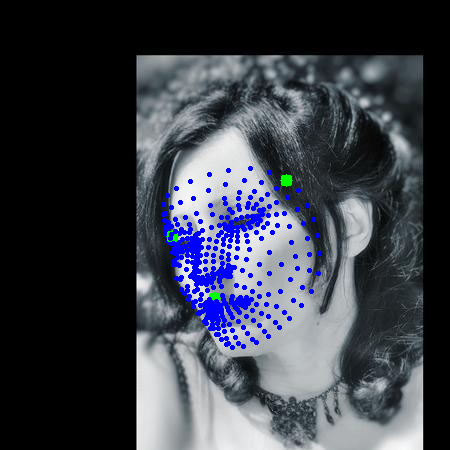

2


In [ ]:
draw(valid_imgs[66])

In [47]:
def get_ouput(image):
  mouth = np.array(())
  nose = np.array(())
  edge = np.array(())
  edge2 = np.array(())
  faceModule = mediapipe.solutions.face_mesh
  # loading image and its correspinding mat file
  with faceModule.FaceMesh(static_image_mode=True) as faces:
      # loading the image
      #image = cv2.imread('/content/AFLW2000/'+random_file) #+'.jpg'
      # processing the face to extract the landmark points (468 point) for each x,y,z
      results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      x_list_list = []
      y_list_list = []
      x_list = []
      y_list = []
      if results.multi_face_landmarks != None: 
        # looping over the faces in the image
        for face in results.multi_face_landmarks:
            x_list = []
            y_list = []
            i = 0
            #face.landmark[0]
            for landmark in face.landmark:
              
                x = landmark.x
                y = landmark.y
                z = landmark.z
                # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
                shape = image.shape 
                relative_x = int(x * shape[1])
                relative_y = int(y * shape[0])
                # cv2.putText(image, str(relative_y), (int(relative_x),int(relative_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 2)
                x_list.append(relative_x)
                y_list.append(relative_y)
                if i ==0: 
                  mouth = np.array((relative_x , relative_y))
                elif i ==1:
                  nose = np.array((relative_x , relative_y))
                elif i == 251 :
                  edge = np.array((relative_x , relative_y))
                elif i == 162:
                  edge2 = np.array((relative_x , relative_y))
                  #cv2.circle(image, (relative_x, relative_y), radius=1, color=(255, 0, 0), thickness=2)
                #else:
                  #cv2.circle(image, (relative_x, relative_y), radius=1, color=(0, 255, 0), thickness=2)
                i+=1
            #print(len(face.landmark))
            x_list_list.append(x_list)
            y_list_list.append(y_list) # if the image contains more than one face
        #cv2_imshow(image)
        #print(len(x_list_list))
        #print(len(y_list_list[0]))
        #print(x_list_list[0]) #0(mouth),1(nose)
  return np.array(x_list) , np.array(y_list) , edge , edge2 

In [52]:
def normalize (x_list , y_list , edge1 , edge2):
  if np.linalg.norm(edge1[0] - edge2[0]) == 0 or np.linalg.norm(edge1[1] - edge2[1]) == 0:
    return [] , []
  x_list_normalized = ( x_list - edge1[0] ) / np.linalg.norm(edge1[0] - edge2[0])
  y_list_normalized = (y_list - edge1[1]) / np.linalg.norm(edge1[1] - edge2[1])
  return x_list_normalized , y_list_normalized

In [7]:
def draw(random_file):

  faceModule = mediapipe.solutions.face_mesh
  # loading image and its correspinding mat file
  with faceModule.FaceMesh(static_image_mode=True) as faces:
      # loading the image
      image = cv2.imread('/content/AFLW2000/'+random_file) #+'.jpg'
      # processing the face to extract the landmark points (468 point) for each x,y,z
      results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      if results.multi_face_landmarks != None: 
        # looping over the faces in the image
        print('shape is ' , image.shape)
        for face in results.multi_face_landmarks:

            i = 0
            for landmark in face.landmark:
              
                x = landmark.x
                y = landmark.y
                z = landmark.z
                # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
                shape = image.shape 
                relative_x = int(x * shape[1])
                relative_y = int(y * shape[0])
                # cv2.putText(image, str(relative_y), (int(relative_x),int(relative_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 2)
                if i == 251 or i==162 or i==0:
                  cv2.circle(image, (relative_x, relative_y), radius=1, color=(0, 255, 0), thickness=10)
                  #print('dfafdafgafgaafafddafsafds')
                else:
                  cv2.circle(image, (relative_x, relative_y), radius=1, color=(255, 0, 0), thickness=2)
                i+=1
            #print(len(face.landmark))
            

  cv2_imshow(image)
  print(2)



In [8]:
# choosing random image
random_file = 'image00838'
random_file = all_imgs[50]

def get_xy_points(random_file):
## this is a function to extract all the x,y points from the imag 
## input : img_name
## ouput : two list of lists and two tuples x_list , y_list , mouth , nose 
## mouth (tuple) , nose : tuple

  mouth = np.array(())
  nose = np.array(())
  edge = np.array(())
  edge2 = np.array(())
  faceModule = mediapipe.solutions.face_mesh
  # loading image and its correspinding mat file
  with faceModule.FaceMesh(static_image_mode=True) as faces:
      # loading the image
      image = cv2.imread('/content/AFLW2000/'+random_file) #+'.jpg'
      # processing the face to extract the landmark points (468 point) for each x,y,z
      results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      x_list_list = []
      y_list_list = []
      x_list = []
      y_list = []
      if results.multi_face_landmarks != None: 
        # looping over the faces in the image
        for face in results.multi_face_landmarks:
            x_list = []
            y_list = []
            i = 0
            #face.landmark[0]
            for landmark in face.landmark:
              
                x = landmark.x
                y = landmark.y
                z = landmark.z
                # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
                shape = image.shape 
                relative_x = int(x * shape[1])
                relative_y = int(y * shape[0])
                # cv2.putText(image, str(relative_y), (int(relative_x),int(relative_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 2)
                x_list.append(relative_x)
                y_list.append(relative_y)
                if i ==0: 
                  mouth = np.array((relative_x , relative_y))
                elif i ==1:
                  nose = np.array((relative_x , relative_y))
                elif i == 251 :
                  edge = np.array((relative_x , relative_y))
                elif i == 162:
                  edge2 = np.array((relative_x , relative_y))
                  #cv2.circle(image, (relative_x, relative_y), radius=1, color=(255, 0, 0), thickness=2)
                #else:
                  #cv2.circle(image, (relative_x, relative_y), radius=1, color=(0, 255, 0), thickness=2)
                i+=1
            #print(len(face.landmark))
            x_list_list.append(x_list)
            y_list_list.append(y_list) # if the image contains more than one face
        #cv2_imshow(image)
        #print(len(x_list_list))
        #print(len(y_list_list[0]))
        #print(x_list_list[0]) #0(mouth),1(nose)
  return np.array(x_list) , np.array(y_list) , edge , edge2


In [9]:
def get_ouput(random_file):
  ## takes the name of the image and return the ouput (pitch , yaw , roll)
  image = cv2.imread('/content/AFLW2000/'+random_file)
  # loading the mat file to extract the 3 angels of the face (pitch,yaw,roll)
  random_file_mat = random_file.replace('.jpg','.mat')
  mat_file = sio.loadmat('/content/AFLW2000/'+random_file_mat)
  # extracting the labels 3 angels
  pose_para = mat_file["Pose_Para"][0][:3]
  pitch = pose_para[0]
  yaw = pose_para[1]
  roll = pose_para[2]
  return pitch , yaw ,roll

def show_img_with_axis(image , pitch , yaw , roll):
  cv2_imshow(draw_axis(image,pitch,yaw,roll))


In [10]:
x = 'actual'
x = x.replace('a','')
x

'ctul'